# Code to create the plots for the poster
Try it out online with a Binder environement! 

Import all the packages you'll need

In [1]:
%%capture
%load_ext autoreload
%autoreload 2
from polartoolkit import maps, fetch, regions, profiles, utils
import pygmt
import os
import pathlib

## Download and plot Greenland Bedmachine data

In [61]:
os.environ["POLARTOOLKIT_HEMISPHERE"] = "north"

In [62]:
# download data
bed = fetch.bedmachine(
    layer="bed",
    region=regions.north_greenland,
)

grdcut [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdcut [WARNING]: e reset from 600000 to 600100
grdcut [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdcut [WARNING]: s reset from -1200000 to -1200050
grdcut [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdcut [WARNING]: w reset from -500000 to -500100
grdcut [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdcut [WARNING]: n reset from -650000 to -649950


gmtset [WARNING]: Representation of font type not recognized. Using default.


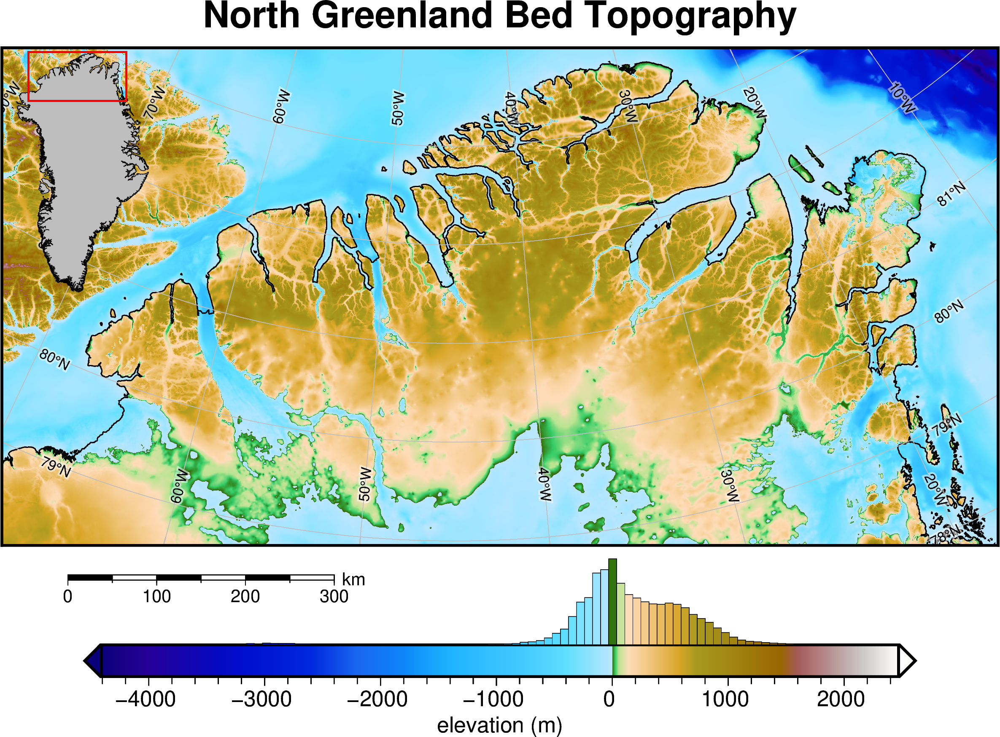

In [63]:
# plot map
fig = maps.plot_grd(
    bed,
    fig_height=10,              # set figure height in cm
    cmap="etopo1",              # set the colormap
    coast=True,                 # plot grounding and coastlines
    title="North Greenland Bed Topography", # add title
    cbar_label="elevation (m)", # add label
    inset=True,                 # add inset map
    scalebar=True,              # add scalebar
    scale_position="n.2/-.07",  # position of scalebar
    gridlines=True,             # add lat/lon gridlines
    hist=True,                  # add a colorbar histogram
)

# display
fig.show()

In [64]:
fig.savefig("poster_v3/north_greenland_bed.png", transparent=True, dpi=500)

## Subplots

In [48]:
os.environ["POLARTOOLKIT_HEMISPHERE"] = "south"

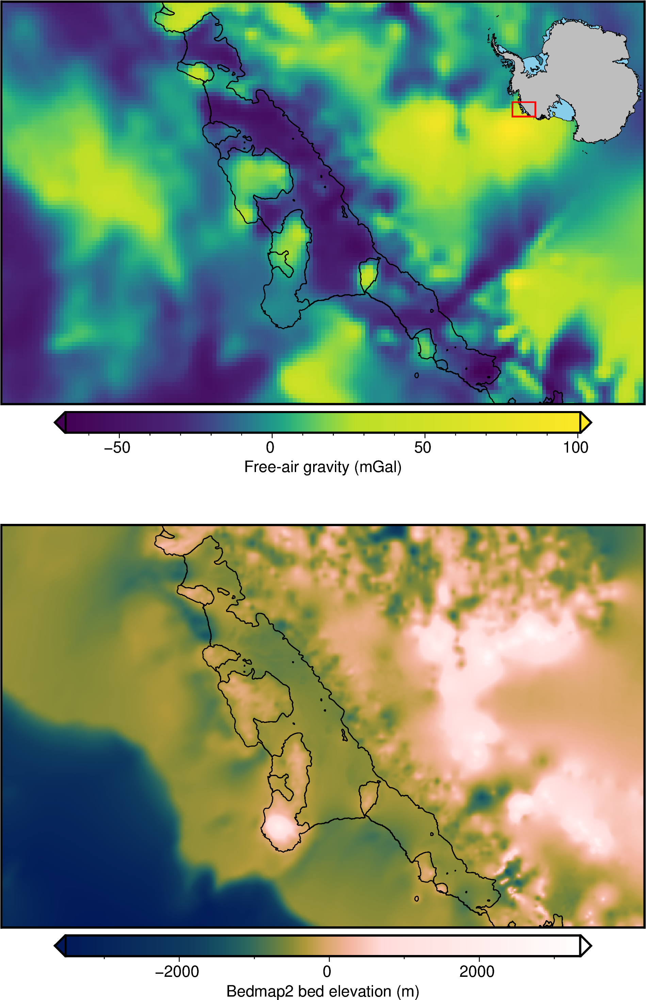

In [49]:
# define a region
region = (-1800e3, -1000e3, -1200e3, -700e3)

# download
bed = fetch.bedmap2(
    "bed",
    spacing=1e3,
)
gravity = fetch.gravity(
    version="antgg-update",
    anomaly_type="FA",
    spacing=5e3,
    region=region,
)

# plot
fig = maps.plot_grd(
    bed,
    fig_height=10,
    region=region,
    grd2cpt=True,
    cmap="batlowW",
    coast=True,
    cbar_label="Bedmap2 bed elevation (m)",
    grid_lines=True,
)

fig = maps.plot_grd(
    gravity,
    fig_height=10,
    region=region,
    grd2cpt=True,
    cmap="viridis",
    coast=True,
    cbar_label="Free-air gravity (mGal)",
    origin_shift="y",
    fig=fig,
    inset=True,
    inset_pos="TR",
    grid_lines=True,
)

# show
fig.show()

## Sample data along a profile
First we need to fetch the datasets to sample. By default the function will sample Bedmap2 layers for the cross section. We will provide out own datasets to show as data profiles.

In [65]:
os.environ["POLARTOOLKIT_HEMISPHERE"] = "south"

In [66]:
# well plot both gravity data and geothermal heat flux data

gravity = fetch.gravity(
    version="antgg-update",
    anomaly_type="BA",
)

GHF = fetch.ghf(version="losing-ebbing-2021")

# add the data and properties to a dictionary
data = profiles.make_data_dict(
    names=["Bouguer gravity", "Geothermal heat flux"],
    grids=[gravity, GHF],
    colors=["blue", "red"],
    axes=[0, 1],  # use separate y axes for plotting
)

Next we need to define our profile location. We have 3 options for that.

* Option 1: use two sets of coordinates to define a line
Coordinates are in meters east and north; EPSG3031 Polar Stereographic Projection
If you don't know which coordinates to use, click on a point on the map and copy and paste the output coordinates to variables `a` and `b`.

* Option 2: use a shapefile as the path

* Option 3: click on an interactive map to create a line

In [67]:
# option 1
# coordinates in meters east and north; EPSG3031 Polar Stereographic Projection
a = [437248.0000000149, -902144.0000000305]
b = [121855.99999999959, -1378303.9999999988]
# click on the below map and copy the output coordinates.

# option 2
# provide your own shapefile, or use fetch to retrieve one
shapefile = fetch.sample_shp("Disco_deep_transect")

# option 3
# use the "Draw a polyline" button on the below map to create a line.
lines = profiles.draw_lines(hemisphere="south")

Label(value='')

Map(center=[-90, 0], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_tex…

In [5]:
# for option 3, we need to extract the clicked vertices
# extract the vertices of the line
line = utils.shapes_to_df(lines)
line

,lon,lat,shape_num,x,y
0,-52.622873,-74.360240,0,-1.358468e+06,1.037768e+06
1,-66.319732,-75.678802,0,-1.432182e+06,6.280960e+05
2,-75.781251,-79.386427,0,-1.120941e+06,2.840320e+05
3,-89.068619,-82.256565,0,-8.424630e+05,1.369600e+04
4,-114.462959,-82.485712,0,-7.441767e+05,-3.385600e+05
5,-125.542844,-80.123746,0,-8.752251e+05,-6.252800e+05
6,-138.689459,-78.859192,0,-8.015089e+05,-9.120000e+05


Now we can make the cross section plot!

gmtset [WARNING]: Representation of font type not recognized. Using default.


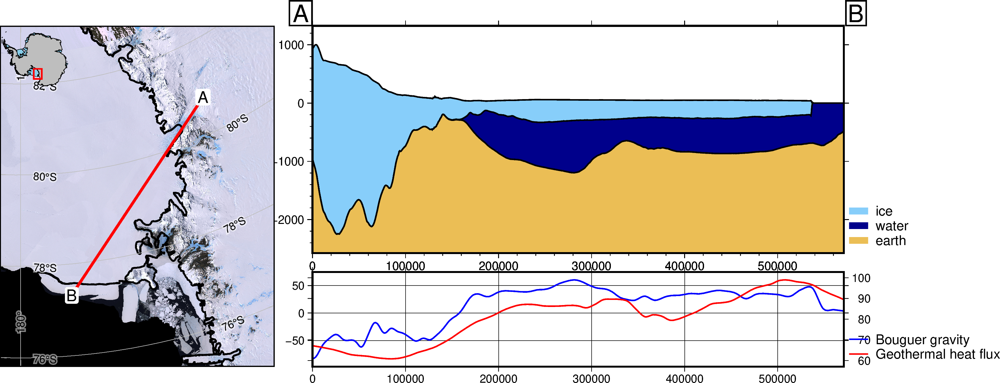

In [6]:
# option 1
# note these can take a minute or two to plot since the imagery file is quite large.
# add `map_background=fetch.bedmap2("surface"),` for a faster plot
fig, df_layers, df_data = profiles.plot_profile(
    method="points",
    start=a,
    stop=b,
    data_dict=data,
    add_map=True,
)
fig.show()

gmtset [WARNING]: Representation of font type not recognized. Using default.


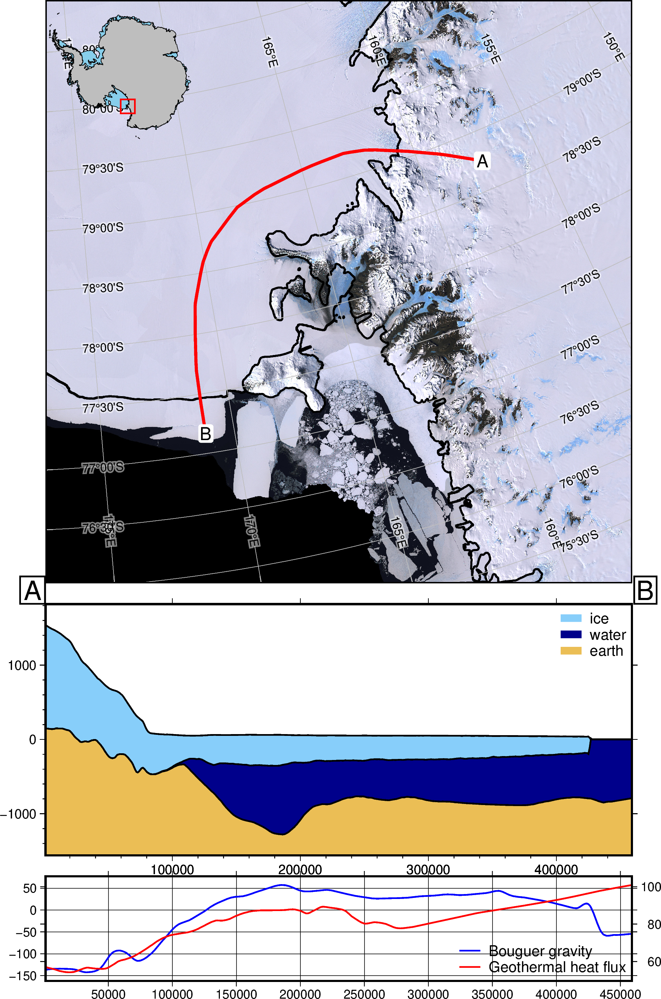

In [68]:
# option 2
fig, df_layers, df_data = profiles.plot_profile(
    method="shapefile",
    shapefile=shapefile,
    data_dict=data,
    add_map=True,
    hemisphere="south",
    subplot_orientation="vertical",
    data_legend_loc="JBR+jBR+o0c",
    layers_legend_loc="JTR+jTR+o0c",
)
fig.show()

In [69]:
fig.savefig("poster_v3/profile.png", transparent=True, dpi=500)

gmtset [WARNING]: Representation of font type not recognized. Using default.


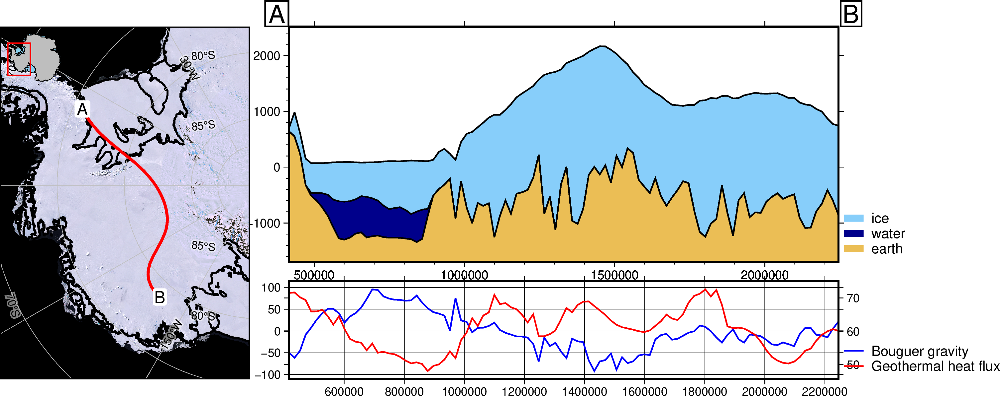

In [8]:
# option 3
fig, df_layers, df_data = profiles.plot_profile(
    method="polyline",
    polyline=line,
    num=100,  # interpolate between clicked points
    data_dict=data,
    add_map=True,
    # map_background=bed,
)
fig.show()

Use the below for a quick and simple cross section

In [10]:
lines = profiles.draw_lines()

Label(value='')

Map(center=[-90, 0], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_tex…

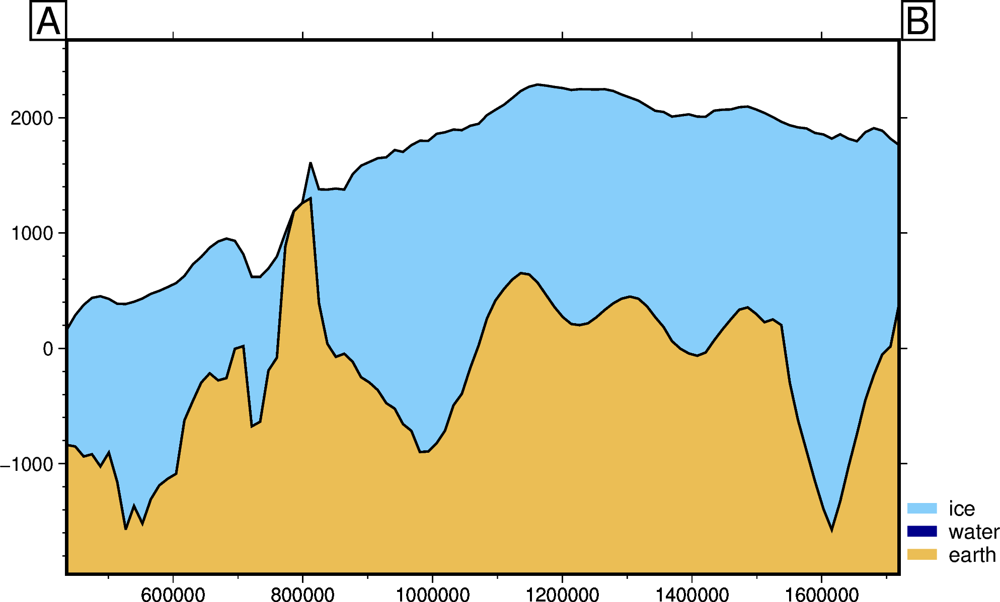

In [12]:
line = utils.shapes_to_df(lines)
fig, _, _ = profiles.plot_profile(
    method="polyline",
    polyline=line,
    num=100,
    # add_map=True
)
fig.show()

## Compare grids

In [70]:
# download data
bedmachine = fetch.bedmachine("bed")
bedmap = fetch.bedmap2("bed")

KeyboardInterrupt: 

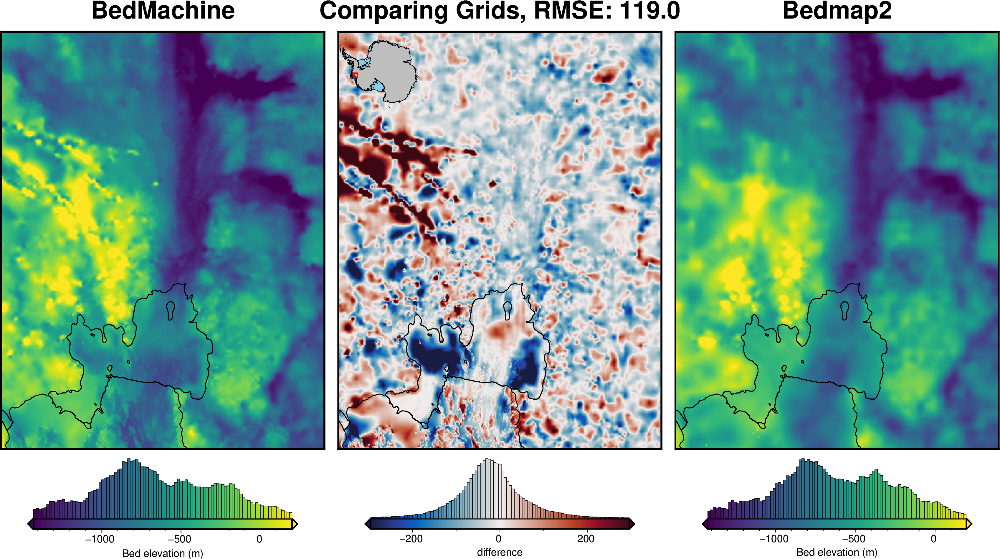

(<xarray.DataArray 'z' (y: 621, x: 481)> Size: 2MB
 array([[286.34393311, 212.86068726, 280.0098877 , ..., -47.24121094,
          26.53564453, -34.91723633],
        [273.21008301, 202.317276  , 268.61589813, ..., -55.81958008,
          20.3092041 , -36.8815918 ],
        [260.49679565, 187.5909729 , 254.92562866, ..., -57.19372559,
          18.546875  , -37.90063477],
        ...,
        [ 88.04248047,  97.95666504,  83.63323975, ..., -37.87683105,
         -48.22167969, -32.69909668],
        [ 86.68878174,  88.12811279,  81.51361084, ..., -36.8637085 ,
         -44.81964111, -30.19210815],
        [ 86.20574951,  81.92565918,  80.62658691, ..., -35.26611328,
         -43.92810059, -28.67260742]])
 Coordinates:
   * x        (x) float64 4kB -1.72e+06 -1.72e+06 ... -1.48e+06 -1.48e+06
   * y        (y) float64 5kB -3.8e+05 -3.795e+05 -3.79e+05 ... -7.05e+04 -7e+04,
 <xarray.DataArray 'z' (y: 621, x: 481)> Size: 1MB
 array([[  309.34393,   300.3607 ,   290.0099 , ..., -1128.2412 ,


In [5]:
# compare grids and plot
_ = utils.grd_compare(
    bedmachine,
    bedmap,
    region=regions.pine_island_glacier,
    plot=True,
    coast=True,
    robust=True,
    grid1_name="BedMachine",
    grid2_name="Bedmap2",
    cbar_label="Bed elevation (m)",
    hist=True,
)

## Extract trend from grid

/home/matt/mambaforge/envs/antarctic_plots_binder/lib/python3.11/site-packages/antarctic_plots/utils.py:729: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["fit"] = trend.predict((df[coords[0]], df[coords[1]]))
/home/matt/mambaforge/envs/antarctic_plots_binder/lib/python3.11/site-packages/antarctic_plots/utils.py:732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["detrend"] = df[coords[2]] - df.fit


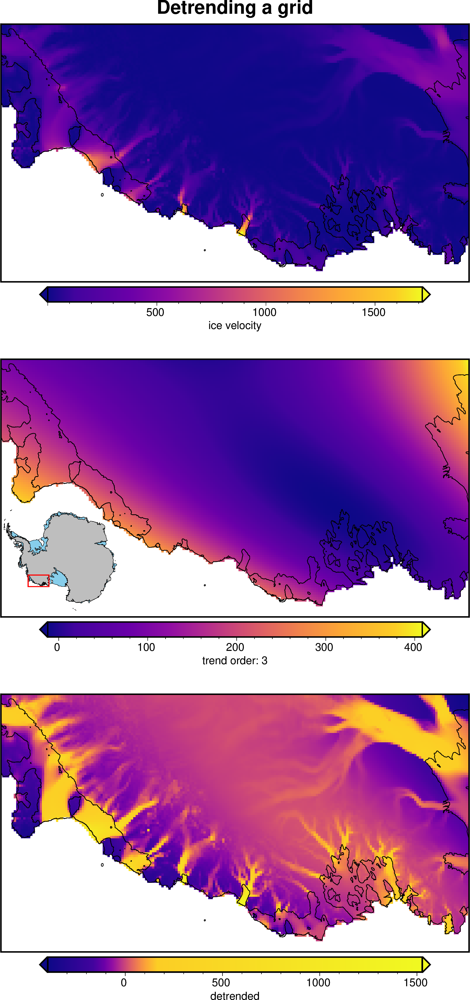

In [4]:
# download
ice_velocity = fetch.ice_vel(region=regions.marie_byrd_land, spacing=5e3)

# extract and detrend
fit, detrend = utils.grd_trend(ice_velocity, deg=3)

# plot
fig = maps.plot_grd(
    detrend,
    fig_height=10,
    cmap="plasma",
    grd2cpt=True,
    coast=True,
    cbar_label="detrended",
)

fig = maps.plot_grd(
    fit,
    fig=fig,
    fig_height=10,
    cmap="plasma",
    grd2cpt=True,
    coast=True,
    cbar_label="trend order: 3",
    inset=True,
    inset_pos="BL",
    origin_shift="yshift",
)

fig = maps.plot_grd(
    ice_velocity,
    fig=fig,
    fig_height=10,
    cmap="plasma",
    grd2cpt=True,
    coast=True,
    cbar_label="ice velocity",
    title="Detrending a grid",
    origin_shift="yshift",
)

fig.show()

## Mask grid with shapefile

In [5]:
# fetch a grid
grid = fetch.bedmap2(layer="surface", spacing=5e3)

# fetch a shapefile
shape = fetch.groundingline(version="depoorter-2013")

import pyogrio

# get just the grounding line
gdf = pyogrio.read_dataframe(shape)
groundingline = gdf[gdf.Id_text == "Grounded ice or land"]

grdsample [WARNING]: Output sampling interval in x exceeds input interval and may lead to aliasing.
grdsample [WARNING]: Output sampling interval in y exceeds input interval and may lead to aliasing.


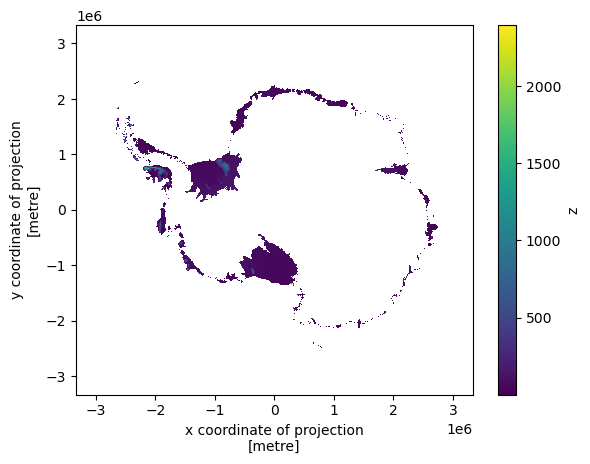

In [6]:
# mask the inside region
masked_inside = utils.mask_from_shp(shapefile=groundingline, xr_grid=grid, masked=True)
masked_inside.plot()

## Use with normal PyGMT commands

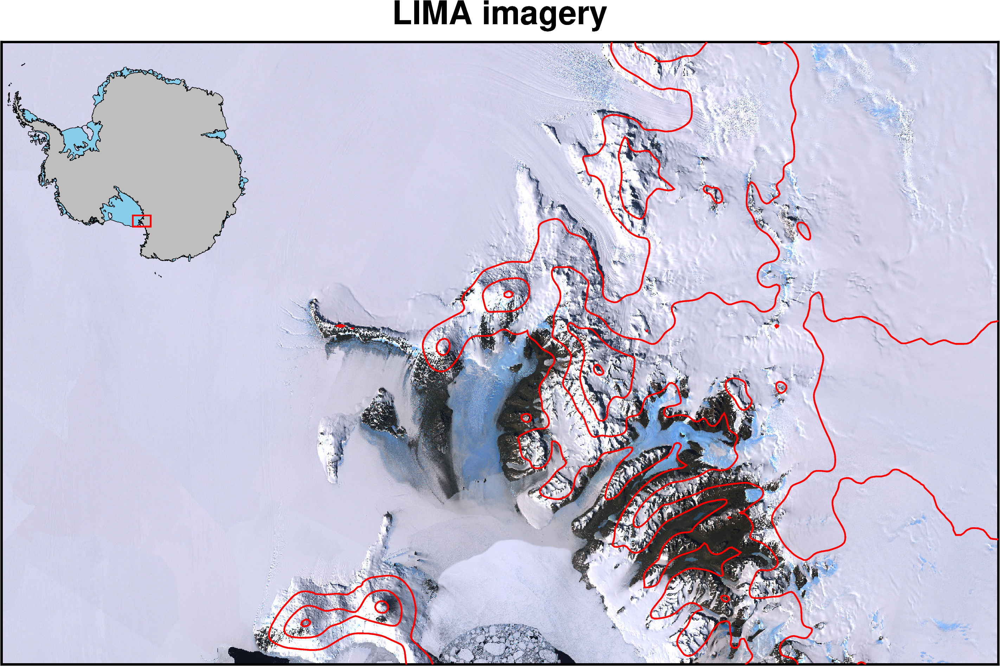

In [13]:
imagery = fetch.imagery()

region = (150e3, 550e3, -1350e3, -1100e3)
# region = regions.minna_bluff

fig = maps.plot_grd(
    imagery,
    region=region,
    image=True,
    inset=True,
    title="LIMA imagery",
    grid_lines=True,
    x_annots=10,  # plot 10 degree longitude lines
    y_annots=2,  # plot 2 degree latitude lines
)

# add surface elevation contours
surface = fetch.bedmap2(layer="surface", region=region, spacing=1e3)
fig.grdcontour(grid=surface, interval=750, pen="thick,red")

fig.show()

## 3D Antarctic drainage basins

In [10]:
os.environ["POLARTOOLKIT_HEMISPHERE"] = "south"

In [11]:
# download the data
ice_velocity = fetch.ice_vel()
bed = fetch.bedmap2(layer="bed")
surface = fetch.bedmap2(layer="surface")

In [5]:
# get smoothed version of surface elevation
# surface_lowres = fetch.resample_grid(surface, spacing=10e3)
surface_lowres_50k = fetch.resample_grid(surface_lowres, spacing=50e3)

grdsample [WARNING]: Output sampling interval in x exceeds input interval and may lead to aliasing.
grdsample [WARNING]: Output sampling interval in y exceeds input interval and may lead to aliasing.


In [14]:
# get antarctic ice basin boundaries
basins = fetch.antarctic_boundaries(version='Basins_IMBIE')

# get antarctic coastline
coastlines = fetch.antarctic_boundaries(version="Coastline")

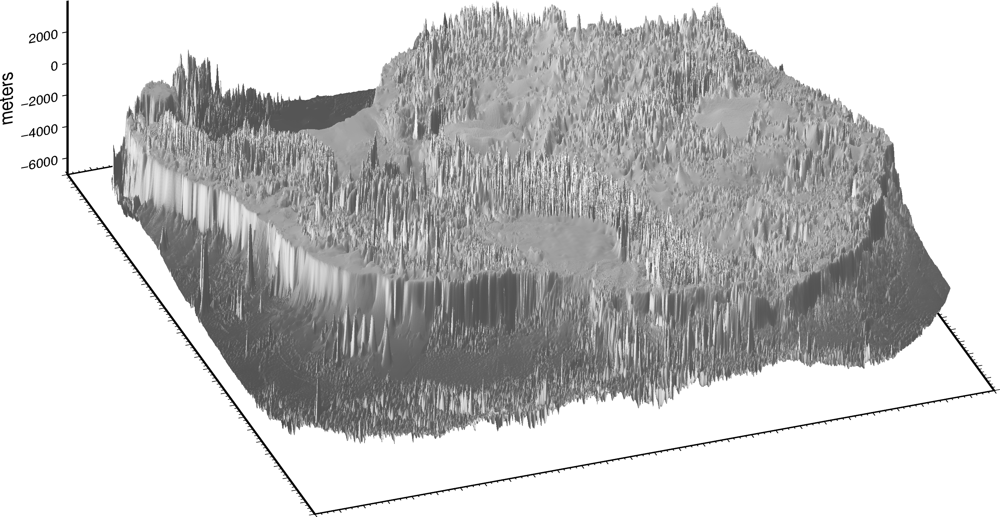

In [55]:
# plot 3D basemap of bed topography
fig = pygmt.Figure()

reg = regions.antarctica

proj, proj_ll, fig_width, fig_height = utils.set_proj(
    reg,
    fig_height=18,
)
perspective=[200,30]

persp_reg = reg+(utils.get_min_max(bed))

pygmt.makecpt(
    cmap="gray",
    series=[-10e3, 5e3],
    background="o",
)
fig.grdview(
    grid=bed,
    region=persp_reg,
    frame=["xa200000f50000","ya200000f50000","z2000+lmeters","wsenZ"],
    perspective=perspective,
    projection=proj,
    zsize='5c',
    surftype='i',
    cmap=True,
    shading=True,
)
fig.show()

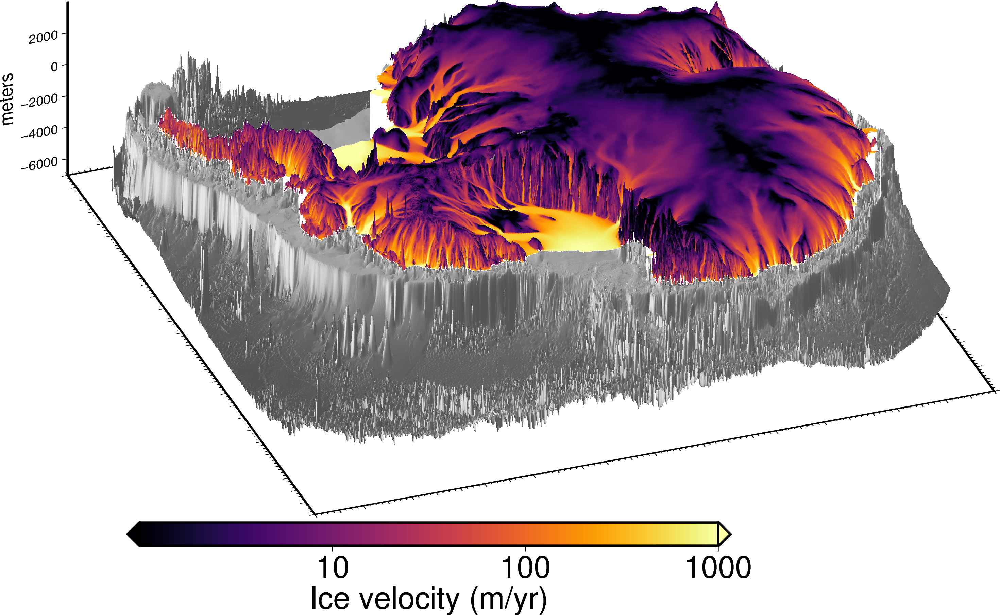

In [56]:
# plot ice surface layer colored by ice velocity
surface = utils.mask_from_shp(
    shapefile=coastlines,
    xr_grid=surface,
    masked=True,
    invert=False,
)
pygmt.makecpt(
    cmap="inferno",
    series=[.001, 3],
    log=True,
    background="o",
)
fig.grdview(
    grid=surface,
    region=persp_reg,
    frame=False,
    perspective=perspective,
    projection=proj,
    zsize='5c',
    surftype='i',
    drapegrid=ice_velocity,
    cmap=True,
)

maps.add_colorbar(
    fig,
    cbar_frame=["a1", "x+lIce velocity (m/yr)"],
    cbar_font="22p,Helvetica,black",
    cbar_log=True,
)

fig.show()

In [57]:
def plot_3d_lines(grid, lines, pen=".7p,black"):
    pygmt.grdtrack(
        grid = grid,
        points = lines,
        outfile="tmp.txt",
        skiprows=True,
        output_type="file",
    )
    fig.plot3d(
        data='tmp.txt',
        pen=pen,
        perspective=True,
        verbose='e',
        no_clip=False,
    )
    pathlib.Path("tmp.txt").unlink()
    return fig

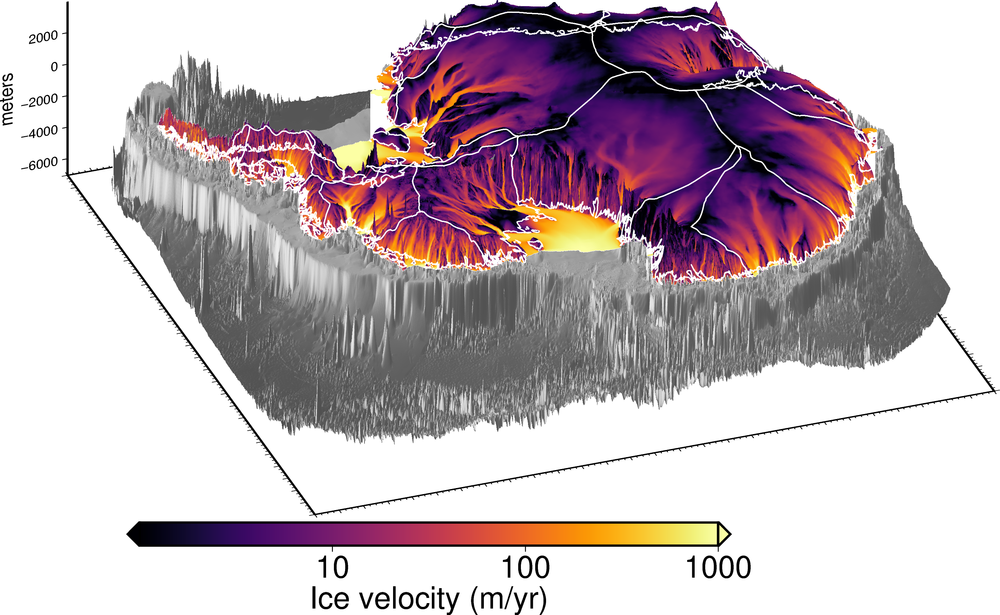

In [59]:
# drape basins onto surface topography
fig = plot_3d_lines(
    surface_lowres_50k,
    lines=basins,
    pen=".7p,white",
)
fig.show()

In [60]:
fig.savefig("poster_v3/3d_antarctica.png", transparent=True, dpi=500)